In [70]:
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
color = sns.color_palette()
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px

# Reading data

https://www.kaggle.com/datasets/snap/amazon-fine-food-reviews?resource=download

In [25]:
df = pd.read_csv('data/Reviews.csv')
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [14]:
fig = px.histogram(df, x='Score')
fig.update_traces(marker_color='turquoise', 
                  marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Score')
fig.show()

In [15]:
import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS

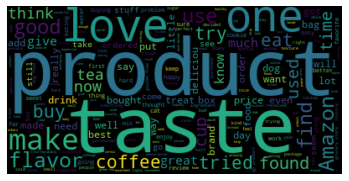

In [18]:
stopwords = set(STOPWORDS)
stopwords.update(['br', 'href'])
text = ' '.join(review for review in df.Text)
wordcloud = WordCloud(stopwords=stopwords).generate(text)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [26]:
df['Score'].value_counts()

5    363122
4     80655
1     52268
3     42640
2     29769
Name: Score, dtype: int64

In [56]:
df['Sentiment'] = df['Score'].apply(lambda rating : +1 if rating > 3 else -1)

In [28]:
positive_df = df[df['Sentiment'] == 1]
negative_df = df[df['Sentiment'] == -1]

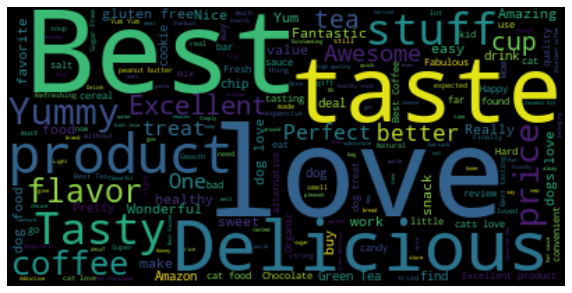

In [30]:
stopwords = set(STOPWORDS)
STOPWORDS.update(['br', 'href', 'good', 'great'])

positive_text = ' '.join(review for review in positive_df.Summary)
wordcloud_positive = WordCloud(stopwords=stopwords).generate(positive_text)

plt.figure(figsize=(10,6))
plt.imshow(wordcloud_positive, interpolation='bilinear')
plt.axis('off')
plt.show()

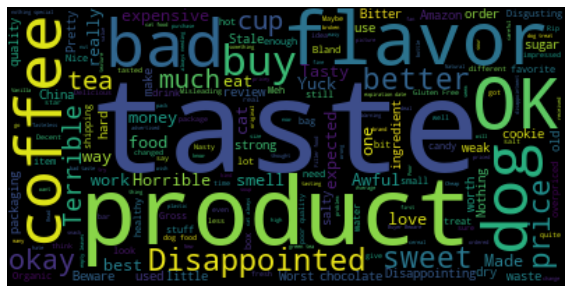

In [39]:
# negative_df.Summary has 27 NaNs, need to drop before processing
negative_text = ' '.join(review for review in negative_df.Summary.dropna())
wordcloud_negative = WordCloud(stopwords=stopwords).generate(negative_text)

plt.figure(figsize=(10,6))
plt.imshow(wordcloud_negative, interpolation='bilinear')
plt.axis('off')
plt.show()

In [59]:
df['Sentiment'] = df['Sentiment'].replace({-1: 'negative', 1: 'positive'})
df['Sentiment'].value_counts()

positive    443777
negative    124677
Name: Sentiment, dtype: int64

In [60]:
fig = px.histogram(df, x='Sentiment')
fig.update_traces(marker_color='indianred', 
                  marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Sentiment')
fig.show()

# Machine Learning

In [61]:
df['Sentiment'] = df['Sentiment'].replace({'negative':0, 'positive':1})
df['Sentiment'].value_counts()

1    443777
0    124677
Name: Sentiment, dtype: int64

In [65]:
remove_spc_char = lambda x : re.sub(r"[^a-zA-Z0-9]+", ' ', x)

In [66]:
df['Text'] =  df['Text'].apply(remove_spc_char)
df['Text'].head()

0    I have bought several of the Vitality canned d...
1    Product arrived labeled as Jumbo Salted Peanut...
2    This is a confection that has been around a fe...
3    If you are looking for the secret ingredient i...
4    Great taffy at a great price There was a wide ...
Name: Text, dtype: object

In [67]:
df = df.dropna(subset=['Summary'])
df['Summary'] = df['Summary'].apply(remove_spc_char)
df['Summary'].head()

0    Good Quality Dog Food
1        Not as Advertised
2      Delight says it all
3           Cough Medicine
4              Great taffy
Name: Summary, dtype: object

In [68]:
df[['Summary', 'Sentiment']].head()

,Summary,Sentiment
0,Good Quality Dog Food,1
1,Not as Advertised,0
2,Delight says it all,1
3,Cough Medicine,0
4,Great taffy,1


In [118]:
from sklearn.model_selection import train_test_split

X = df['Summary']
y = df['Sentiment']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [119]:
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline

pipe = Pipeline([('cv', CountVectorizer()),('lr', LogisticRegression(max_iter=1500))])

In [120]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('cv', CountVectorizer()),
                ('lr', LogisticRegression(max_iter=1500))])

In [121]:
predictions = pipe.predict(X_test)

In [122]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

confusion_matrix(y_test, predictions)

array([[16342,  8527],
       [ 3682, 85135]])

In [123]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.82      0.66      0.73     24869
           1       0.91      0.96      0.93     88817

    accuracy                           0.89    113686
   macro avg       0.86      0.81      0.83    113686
weighted avg       0.89      0.89      0.89    113686



# Scraping tweets with Twitter API

In [132]:
import requests
import os
import json

# To set your environment variables in your terminal run the following line:
# export 'BEARER_TOKEN'='<your_bearer_token>'
bearer_token = 'AAAAAAAAAAAAAAAAAAAAALhFcgEAAAAAPY%2BdzxVKlVGdZDMkCuuOTkxQFQU%3DfDlCKQLM4XU5vgLfsE7ENxPgTHgEkOsXri1D0KBri08Ae1LCLu'

#bearer_token = os.environ.get("BEARER_TOKEN")

search_url = "https://api.twitter.com/2/tweets/search/recent"

# Optional params: start_time,end_time,since_id,until_id,max_results,next_token,
# expansions,tweet.fields,media.fields,poll.fields,place.fields,user.fields
query_params = {
    'query': '(from:twitterdev -is:retweet) OR #twitterdev',
    'tweet.fields': 'author_id'}


def bearer_oauth(r):
    """
    Method required by bearer token authentication.
    """

    r.headers["Authorization"] = f"Bearer {bearer_token}"
    r.headers["User-Agent"] = "v2RecentSearchPython"
    return r

def connect_to_endpoint(url, params):
    response = requests.get(url, auth=bearer_oauth, params=params)
    print(response.status_code)
    if response.status_code != 200:
        raise Exception(response.status_code, response.text)
    return response.json()


def scrap_tweets(search_url, query_params):
    json_response = connect_to_endpoint(search_url, query_params)
    return json.dumps(json_response, indent=4, sort_keys=True)

print(scrap_tweets(search_url, query_params))

200
{
    "data": [
        {
            "author_id": "2244994945",
            "id": "1525143950440337408",
            "text": "\ud83d\udce3 Jump in to hear @alanbenlee, @jamie_maguire1, and the @charmcli team on Thursday, 5/19 at 12pm ET/9am PT as they discuss OSS development tools. \u2699\ufe0f\ud83d\udee0\n\nSet a reminder \ud83d\udc47\nhttps://t.co/fWljPVHTwi"
        },
        {
            "author_id": "980717503985922048",
            "id": "1525138953858342912",
            "text": "RT @skolo_online: How can I use the Twitter API to get the most out of my Twitter account? \n#TwitterAPI #TwitterDev #pythonadvanceprojects\u2026"
        },
        {
            "author_id": "1488089966588616710",
            "id": "1525134469363023874",
            "text": "RT @skolo_online: How can I use the Twitter API to get the most out of my Twitter account? \n#TwitterAPI #TwitterDev #pythonadvanceprojects\u2026"
        },
        {
            "author_id": "1268805305846181891",
      